# Section 2
## Structuring Biomedical Data Using Networks 

- talk about features of biomedical datasets and the issues around working with them
 - heterogeneity of data types
 - outliers, noise, missing values
 - network construction decisions - filtering, kNN, similarity calulation - effects of different data modalities
 - introduce some of the key data types - transcriptomics, methylation etc.
 - introduce GenScot study and describe the data
- notebooks doing the initial processing of example data set(s) culminating with the GenScot set
- emerge from sessions with a selection of networks to work on later in the workshop

# Workshop Agenda: Working with ASD Data and Network Analysis

## 1. Data Management
   - **1.1 Saving Data**: Techniques for efficient data storage.
   - **1.2 Loading Data**: Best practices for importing data.
   - **1.3 Data Cleaning**:
     - Checking for and handling missing data.
     - Outlier detection and remediation.
   - **1.4 Data Visualization**:
     - Creating metadata plots for basic analysis of patient numbers.
     - Evaluating features through simple plots.
   - **1.5 Assessing Data Quality**:
     - Checking for heterogeneity in the data.

## 2. Network Generation
   - **2.1 Correlation Matrix**: Construction and analysis.
   - **2.2 Data Preprocessing**:
     - Scaling and normalization.
     - Log transformation.
     - Analyzing variable distribution.
   - **2.3 Correlation Measures**:
     - Pearson, Spearman, and Euclidean correlations.
     - Absolute biweight midcorrelation.
     - Log-transformed Pearson correlation.
   - **2.4 Outputting the Adjacency Matrix**: From correlation to network structure.

## 3. Network Sparsification
   - **3.1 Thresholding Methods**:
     - Thresholding by degree.
     - Thresholding by closeness.
     - Thresholding by edge weight.
   - **3.2 k-Nearest Neighbors (KNN)**:
     - Basic KNN sparsification.
     - KNN combined with thresholding.
   - **3.3 Advanced Sparsification Techniques**:
     - Maximizing edge weight retention.
   - **3.4 Managing Graph Objects**:
     - Selecting the optimal graph representat

## TODO add SFARI genes as labels and show some visualization techniquesion for progressing to gene networks.

## 4. Types of Networks
   - **4.1 Gene Correlation Networks**: Building and analyzing.
   - **4.2 Weighted Gene Co-expression Network Analysis (WGCNA)**:
     - Building networks analogous to Protein-Protein Interaction (PPI) networks.
   - **4.3 Patient Similarity Networks**: Exploring new methodologies for patient data.

## 5. Integrating Other Datasets
   - **5.1 Data Integration**:
     - Techniques for incorA sessions to enhance understanding and engagement.
r datasets

## Data

- ScotGen,
- ASD transcriptomic,
- Synaptic PPI 

## Autism Spectrum Disorder data



In [1]:
# import used libraries
import pandas as pd
import numpy as np
from scipy import stats
import networkx as nx
import matplotlib.pyplot as plt
import pickle

<frozen importlib._bootstrap>:228: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject


In [2]:
data = pd.read_csv(r"C:\cdt_data\ASD_magdalena\DS_10283_3827\RNASeq\RNASeq\RNAseq_ASD_datExpr.csv")

data.rename(columns={'Unnamed: 0': 'Patient_ID'}, inplace=True)

# data = data.head(100)

# Transpose the data so that genes are columns and rows are observations
data = data.set_index('Patient_ID').T

FileNotFoundError: [Errno 2] No such file or directory: 'C:\\cdt_data\\ASD_magdalena\\DS_10283_3827\\RNASeq\\RNASeq\\RNAseq_ASD_datExpr.csv'

In [3]:

# data = data.iloc[:, :1000]


In [9]:
data

Patient_ID,ENSG00000000003,ENSG00000000005,ENSG00000000419,ENSG00000000457,ENSG00000000460,ENSG00000000938,ENSG00000000971,ENSG00000001036,ENSG00000001084,ENSG00000001167,...,ENSG00000273489,ENSG00000273490,ENSG00000273491,ENSG00000273492,ENSG00000273493,__no_feature,__ambiguous,__too_low_aQual,__not_aligned,__alignment_not_unique
01_052914,63,1,105,284,72,24,159,155,715,488,...,4,0,0,68,3,12726121,324319,0,0,5842658
01_053014,73,3,172,243,39,21,139,139,682,445,...,1,0,0,31,0,11801279,277372,0,0,3951895
01_061914,100,4,127,266,55,25,71,141,669,554,...,7,0,0,70,0,18192534,314101,0,0,7507251
01_072114,80,0,85,280,63,67,154,123,526,437,...,4,0,0,23,1,19509561,231035,0,0,3863531
01_072214,72,0,146,296,50,28,433,192,642,543,...,4,0,0,31,2,11825201,285657,0,0,4125572
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41_072214,81,2,126,193,55,61,192,135,513,516,...,26,0,0,36,1,19612339,239329,0,0,4656268
41_082014,64,2,106,222,41,27,129,131,434,423,...,9,0,0,29,3,14594164,238705,0,0,3922692
45_071514,78,1,160,277,75,46,153,169,690,580,...,4,0,0,20,4,14017074,317867,0,0,6812698
13_081514,72,1,78,238,90,11,61,107,707,562,...,8,0,0,24,2,18614266,275348,0,0,7636206


## 1.3 Check for NA, handling missing data, outlier check

In [10]:
# Check for missing values in each column
missing_values = data.isnull().sum()

# Calculate the percentage of missing values for each column
missing_percentage = (missing_values / len(data)) * 100

# Create a DataFrame to hold the missing data statistics
missing_stats = pd.DataFrame({'Total Missing': missing_values, 'Percentage': missing_percentage})

# Filter to display only columns with missing values
missing_stats = missing_stats[missing_stats['Total Missing'] > 0]

# Print out the missing values statistics for columns with missing data
if not missing_stats.empty:
    print("Missing values in columns:")
    print(missing_stats)
else:
    print("No missing values found in the dataset.")

No missing values found in the dataset.


In [6]:
# Check for negative values

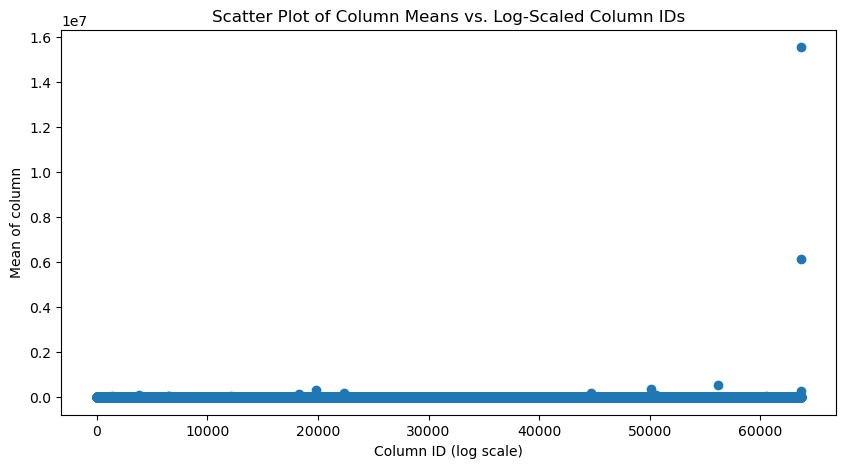

In [11]:
df = pd.DataFrame(data)

# Calculate the mean of each column
means = df.mean()

# Create a list of column IDs (integer index)
column_ids = np.arange(len(df.columns))

# Plotting
plt.figure(figsize=(10, 5))
plt.scatter(column_ids, means)

# Setting the x-axis to a log scale
#plt.yscale('log')

# Labeling the axes
plt.xlabel('Column ID (log scale)')
plt.ylabel('Mean of column')

# Adding a title
plt.title('Scatter Plot of Column Means vs. Log-Scaled Column IDs')

# Adjust xticks to label each point with the corresponding column name
#plt.xticks(column_ids, df.columns)

plt.show()

In [12]:
# Sort the means in descending order and get the top 10
top_10_columns = means.sort_values(ascending=False).head(10)

# Print the results
print("Top 10 columns based on their mean values:")
print(top_10_columns)

Top 10 columns based on their mean values:
Patient_ID
__no_feature              1.554640e+07
__alignment_not_unique    6.160270e+06
ENSG00000265150           5.270622e+05
ENSG00000258486           3.581358e+05
ENSG00000202198           3.081574e+05
__ambiguous               2.858661e+05
ENSG00000251562           1.753168e+05
ENSG00000210082           1.675279e+05
ENSG00000198804           1.607942e+05
ENSG00000259001           1.111658e+05
dtype: float64


In [13]:
# Sort the means in ascending order and get the bottom 10
bottom_10_columns = means.sort_values(ascending=True).head(10)

# Print the results
print("Bottom 10 columns based on their mean values:")
print(bottom_10_columns)

Bottom 10 columns based on their mean values:
Patient_ID
ENSG00000221266    0.0
ENSG00000262812    0.0
ENSG00000262811    0.0
ENSG00000262809    0.0
ENSG00000234454    0.0
ENSG00000262808    0.0
ENSG00000262806    0.0
ENSG00000262805    0.0
ENSG00000234448    0.0
ENSG00000234443    0.0
dtype: float64


In [14]:
# List columns that start with "__"
prefix = "__"
columns_starting_with_prefix = [col for col in df.columns if col.startswith(prefix)]

# Print the results
print("Columns starting with '__':")
print(columns_starting_with_prefix)

Columns starting with '__':
['__no_feature', '__ambiguous', '__too_low_aQual', '__not_aligned', '__alignment_not_unique']


In [15]:
# drop weird columns
data.drop(columns = columns_starting_with_prefix, inplace=True)

In [16]:
data

Patient_ID,ENSG00000000003,ENSG00000000005,ENSG00000000419,ENSG00000000457,ENSG00000000460,ENSG00000000938,ENSG00000000971,ENSG00000001036,ENSG00000001084,ENSG00000001167,...,ENSG00000273484,ENSG00000273485,ENSG00000273486,ENSG00000273487,ENSG00000273488,ENSG00000273489,ENSG00000273490,ENSG00000273491,ENSG00000273492,ENSG00000273493
01_052914,63,1,105,284,72,24,159,155,715,488,...,0,0,10,52,8,4,0,0,68,3
01_053014,73,3,172,243,39,21,139,139,682,445,...,0,2,9,70,7,1,0,0,31,0
01_061914,100,4,127,266,55,25,71,141,669,554,...,0,1,16,203,16,7,0,0,70,0
01_072114,80,0,85,280,63,67,154,123,526,437,...,0,2,21,32,20,4,0,0,23,1
01_072214,72,0,146,296,50,28,433,192,642,543,...,0,3,13,66,12,4,0,0,31,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41_072214,81,2,126,193,55,61,192,135,513,516,...,0,1,16,66,15,26,0,0,36,1
41_082014,64,2,106,222,41,27,129,131,434,423,...,0,1,12,38,16,9,0,0,29,3
45_071514,78,1,160,277,75,46,153,169,690,580,...,0,0,7,69,20,4,0,0,20,4
13_081514,72,1,78,238,90,11,61,107,707,562,...,0,3,10,48,21,8,0,0,24,2


## Handling Missing data ??
### TODO: low priority

In [17]:
num_plots

NameError: name 'num_plots' is not defined

## Data heterogeneity

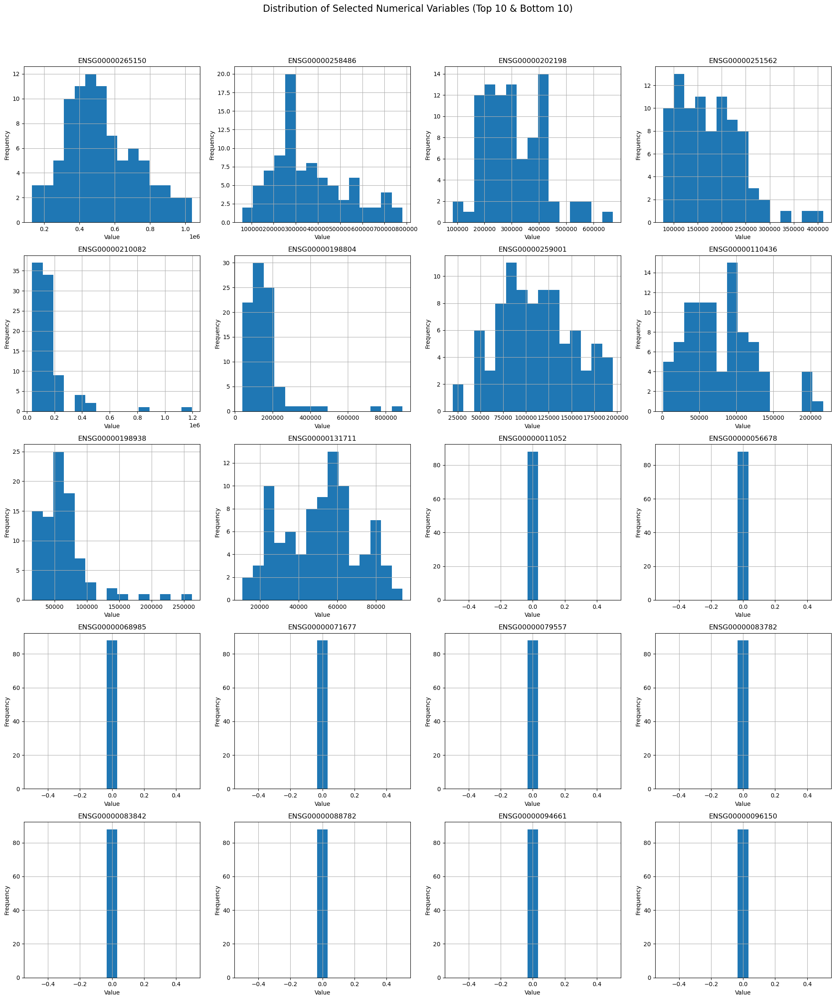

In [18]:
# Select numerical columns
numerical_columns = data.select_dtypes(include=['float64', 'int64'])

# Calculate the mean of each column
means = numerical_columns.mean()

# Get the top 10 and bottom 10 columns based on mean values
top_10_columns = means.nlargest(10).index.tolist()
bottom_10_columns = means.nsmallest(10).index.tolist()

# Combine top 10 and bottom 10 columns for plotting
columns_to_plot = top_10_columns + bottom_10_columns

# Filter the numerical columns to only include those to plot
filtered_numerical_columns = numerical_columns[columns_to_plot]

# Calculate the number of rows needed for subplots based on the number of selected columns
num_plots = len(filtered_numerical_columns.columns)
num_rows = (num_plots // 4) + (num_plots % 4 > 0)  # Ensure there is an extra row if there are leftovers

# Plot histograms for each selected numerical column
fig, axes = plt.subplots(num_rows, 4, figsize=(20, 5 * num_rows))  # Adjust width and height as needed
fig.suptitle('Distribution of Selected Numerical Variables (Top 10 & Bottom 10)', fontsize=16)

for i, col in enumerate(filtered_numerical_columns.columns):
    ax = axes.flatten()[i]
    filtered_numerical_columns[col].hist(bins=15, ax=ax)
    ax.set_title(col)
    ax.set_xlabel('Value')
    ax.set_ylabel('Frequency')

# Hide any unused axes if the number of plots isn't a perfect multiple of 4
if num_plots % 4:
    for ax in axes.flatten()[num_plots:]:
        ax.set_visible(False)

plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Adjust layout to make room for the suptitle
plt.show()

# TODO: consider to DROP GENES BASED ON LOW EXPRESSION VALUE?
yes

In [19]:
# For categorical data, you can use bar plots to visualize the frequency of each category
categorical_columns = data.select_dtypes(include=['object']).columns
for column in categorical_columns:
    plt.figure(figsize=(10, 4))
    data[column].value_counts().plot(kind='bar')
    plt.title(f'Distribution of {column}')
    plt.show()

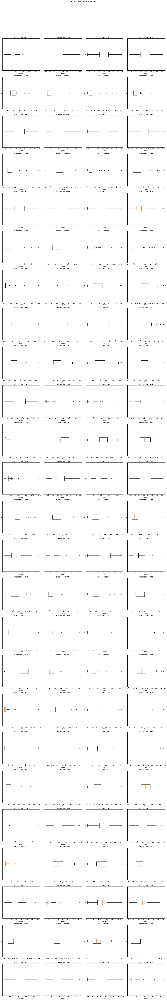

In [35]:
import matplotlib.pyplot as plt

numerical_columns = data.select_dtypes(include=['float64', 'int64'])

# Determine the number of rows and columns for the subplot grid
columns_per_row = 4  # Number of columns in each row of subplots
num_columns = len(numerical_columns.columns)
num_rows = (num_columns // columns_per_row) + (num_columns % columns_per_row > 0)

# Create a figure with subplots in a grid
fig, axes = plt.subplots(num_rows, columns_per_row, figsize=(20, 5 * num_rows))
fig.suptitle('Outliers in Numerical Variables', fontsize=16)

# Flatten axes array to simplify the loop logic
axes = axes.flatten()

for i, col in enumerate(numerical_columns.columns):
    # Plot boxplot for each column
    axes[i].boxplot(data[col].dropna(), vert=False)  # 'vert=False' makes the boxplot horizontal
    axes[i].set_title(col)
    axes[i].set_xlabel('Values')

# Hide unused axes if the number of plots isn't a perfect multiple of the number of columns per row
if num_columns % columns_per_row:
    for ax in axes[num_columns:]:
        ax.set_visible(False)

plt.tight_layout(rect=[0, 0.03, 1, 0.95])  # Adjust the layout to make room for the suptitle
plt.show()

In [21]:
data = data.iloc[:, :10000]

# TODO: ensg to gene name

In [22]:
# Normalizing data - Log transformation
# Adding a pseudocount to avoid log(0) which is undefined
def log_transform(data):
    # Log transformation (log2(x + 1))
    return np.log2(data + 1)

def min_max_scale(data):
    # Min-Max scaling
    return (data - data.min()) / (data.max() - data.min())



In [23]:
# Dictionary to store different correlation matrices
correlation_matrices = {}

# Original data correlation (if applicable/necessary)
correlation_matrices['original'] = data.corr(method='pearson')

# Log transformed data correlation
normalized_log = log_transform(data)
correlation_matrices['log_transformed'] = normalized_log.corr(method='pearson')

# Min-Max scaled data correlation
normalized_min_max = min_max_scale(data)
correlation_matrices['min_max_scaled'] = normalized_min_max.corr(method='pearson')

# Access and use a specific correlation matrix
print("Correlation matrix - Log Transformed:")
#print(correlation_matrices['log_transformed'])



Correlation matrix - Log Transformed:


In [25]:
# Spearman correlation
from scipy.spatial.distance import pdist, squareform


correlation_matrices['spearman'] = data.corr(method='spearman')

# Euclidean distance - converting distance matrix to a DataFrame for compatibility
euclidean_distances = squareform(pdist(data, metric='euclidean'))
correlation_matrices['euclidean'] = pd.DataFrame(euclidean_distances, index=data.index, columns=data.index)

# Now you can access and use the Spearman correlation matrix or the Euclidean distance matrix
print("Spearman Correlation Matrix:")
#print(correlation_matrices['spearman'])

print("\nEuclidean Distance Matrix:")
#print(correlation_matrices['euclidean'])


Spearman Correlation Matrix:

Euclidean Distance Matrix:


In [ ]:
# TODO: FIX ABS_BICORR

def abs_bicorr(data) : 

    data = data._get_numeric_data()
    cols = data.columns
    idx = cols.copy()
    mat = data.to_numpy(dtype=float, na_value=np.nan, copy=False)
    mat = mat.T

    K = len(cols)
    correl = np.empty((K, K), dtype=np.float32)
    mask = np.isfinite(mat)

    bicorr = astropy.stats.biweight_midcovariance(mat)

    for i in range(K) : 
        correl[i , : ] = bicorr[i , :] / np.sqrt(bicorr[i,i] * np.diag(bicorr))
        
    return pd.DataFrame(data = correl , index=idx , columns=cols , dtype=np.float32)

# TODO: what kind of clustering happens in the following heatmaps

C:\Users\sebestyenkamp\anaconda3\envs\ismbenv\Lib\site-packages\seaborn\matrix.py:260: FutureWarning: Format strings passed to MaskedConstant are ignored, but in future may error or produce different behavior
  annotation = ("{:" + self.fmt + "}").format(val)
C:\Users\sebestyenkamp\anaconda3\envs\ismbenv\Lib\site-packages\seaborn\matrix.py:260: FutureWarning: Format strings passed to MaskedConstant are ignored, but in future may error or produce different behavior
  annotation = ("{:" + self.fmt + "}").format(val)
C:\Users\sebestyenkamp\anaconda3\envs\ismbenv\Lib\site-packages\seaborn\matrix.py:260: FutureWarning: Format strings passed to MaskedConstant are ignored, but in future may error or produce different behavior
  annotation = ("{:" + self.fmt + "}").format(val)
C:\Users\sebestyenkamp\anaconda3\envs\ismbenv\Lib\site-packages\seaborn\matrix.py:260: FutureWarning: Format strings passed to MaskedConstant are ignored, but in future may error or produce different behavior
  annotatio

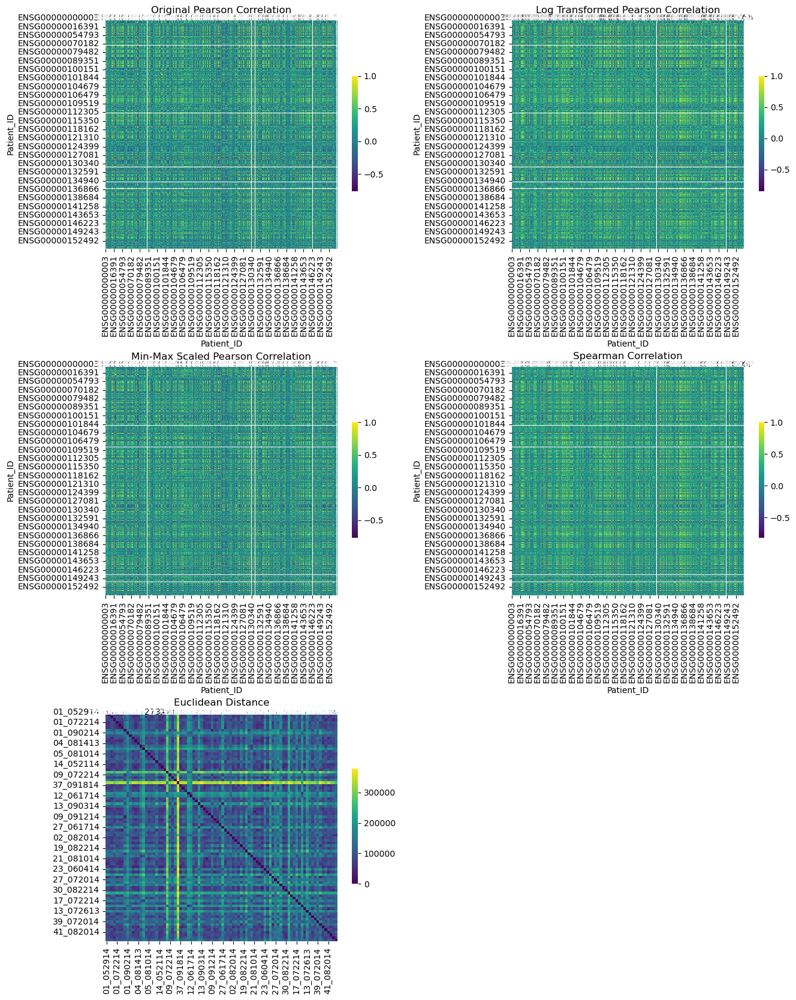

In [27]:
import matplotlib.pyplot as plt
import seaborn as sns

def plot_matrix(matrix, title, ax):
    # Heatmap of the correlation or distance matrix
    sns.heatmap(matrix, ax=ax, cmap='viridis', cbar_kws={'shrink': .5}, annot=True, fmt=".2f")
    ax.set_title(title)

fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(15, 20))
fig.subplots_adjust(hspace=0.5, wspace=0.4)

# Plot each matrix
plot_matrix(correlation_matrices['original'], 'Original Pearson Correlation', axes[0, 0])
plot_matrix(correlation_matrices['log_transformed'], 'Log Transformed Pearson Correlation', axes[0, 1])
plot_matrix(correlation_matrices['min_max_scaled'], 'Min-Max Scaled Pearson Correlation', axes[1, 0])
plot_matrix(correlation_matrices['spearman'], 'Spearman Correlation', axes[1, 1])
plot_matrix(correlation_matrices['euclidean'], 'Euclidean Distance', axes[2, 0])

# Hide the unused subplot (if any)
axes[2, 1].set_visible(False)

plt.show()

In [7]:
# Alternatively use WGCNA ?
# https://github.com/mortazavilab/PyWGCNA?tab=readme-ov-file
# https://en.wikipedia.org/wiki/Weighted_correlation_network_analysis#:~:text=Weighted%20correlation%20network%20analysis%2C%20also,on%20pairwise%20correlations%20between%20variables.

In [ ]:
# Create a graph from the adjacency matrix
G = nx.from_pandas_adjacency(correlation_matrices['original'])

# Plot the network
plt.figure(figsize=(12, 12))
# Position nodes using the spring layout algorithm for nice aesthetics
pos = nx.spring_layout(G)
# Draw nodes and edges
nx.draw_networkx_nodes(G, pos, node_color='skyblue', alpha=0.5, node_size=50)
nx.draw_networkx_edges(G, pos, alpha=0.1)
# Draw node labels
nx.draw_networkx_labels(G, pos, font_size=5, font_family='sans-serif')

# Remove the axis
plt.axis('off')
plt.title('Gene Regulatory Network (GRN)')
plt.show()

In [30]:
correlation_matrices['original']

Patient_ID,ENSG00000000003,ENSG00000000005,ENSG00000000419,ENSG00000000457,ENSG00000000460,ENSG00000000938,ENSG00000000971,ENSG00000001036,ENSG00000001084,ENSG00000001167,...,ENSG00000155621,ENSG00000155622,ENSG00000155629,ENSG00000155636,ENSG00000155640,ENSG00000155657,ENSG00000155659,ENSG00000155660,ENSG00000155666,ENSG00000155714
Patient_ID,,,,,,,,,,,,,,,,,,,,,
ENSG00000000003,1.000000,-0.042486,0.298026,0.223362,0.291175,0.305384,0.423688,0.658827,0.462417,0.432857,...,0.353418,NaN,0.481082,0.283031,0.052522,0.246133,0.453718,0.339164,-0.164747,-0.096215
ENSG00000000005,-0.042486,1.000000,0.177769,0.162953,-0.112138,0.003452,0.035166,0.039170,-0.020925,-0.210681,...,-0.273364,NaN,0.044157,-0.032397,-0.008614,-0.001983,0.010526,-0.111242,-0.028133,0.143119
ENSG00000000419,0.298026,0.177769,1.000000,0.597557,0.093545,-0.007350,0.067359,0.335385,0.428808,0.222787,...,0.167196,NaN,0.181603,0.297941,0.111203,-0.171529,0.062529,0.359968,0.163283,0.165181
ENSG00000000457,0.223362,0.162953,0.597557,1.000000,0.277404,-0.159248,-0.048439,0.203196,0.380732,-0.009258,...,-0.040278,NaN,0.005829,0.476490,0.187316,-0.156072,-0.020087,-0.038488,0.480332,0.239516
ENSG00000000460,0.291175,-0.112138,0.093545,0.277404,1.000000,0.242848,0.223986,0.484996,0.109299,0.368052,...,0.340127,NaN,0.402731,0.459763,0.238576,0.000228,0.440603,0.246293,0.382062,0.123713
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ENSG00000155657,0.246133,-0.001983,-0.171529,-0.156072,0.000228,-0.035157,0.076859,-0.024595,0.082845,0.153609,...,0.086302,NaN,-0.077452,0.117541,0.213879,1.000000,-0.100157,-0.023396,-0.007390,-0.009455
ENSG00000155659,0.453718,0.010526,0.062529,-0.020087,0.440603,0.749756,0.537771,0.726786,0.009087,0.197822,...,0.086919,NaN,0.944830,0.059042,0.239810,-0.100157,1.000000,0.462384,-0.123507,0.052848
ENSG00000155660,0.339164,-0.111242,0.359968,-0.038488,0.246293,0.671194,0.495571,0.649149,0.234953,0.475681,...,0.339656,NaN,0.621980,-0.089353,0.261522,-0.023396,0.462384,1.000000,-0.149444,0.131492


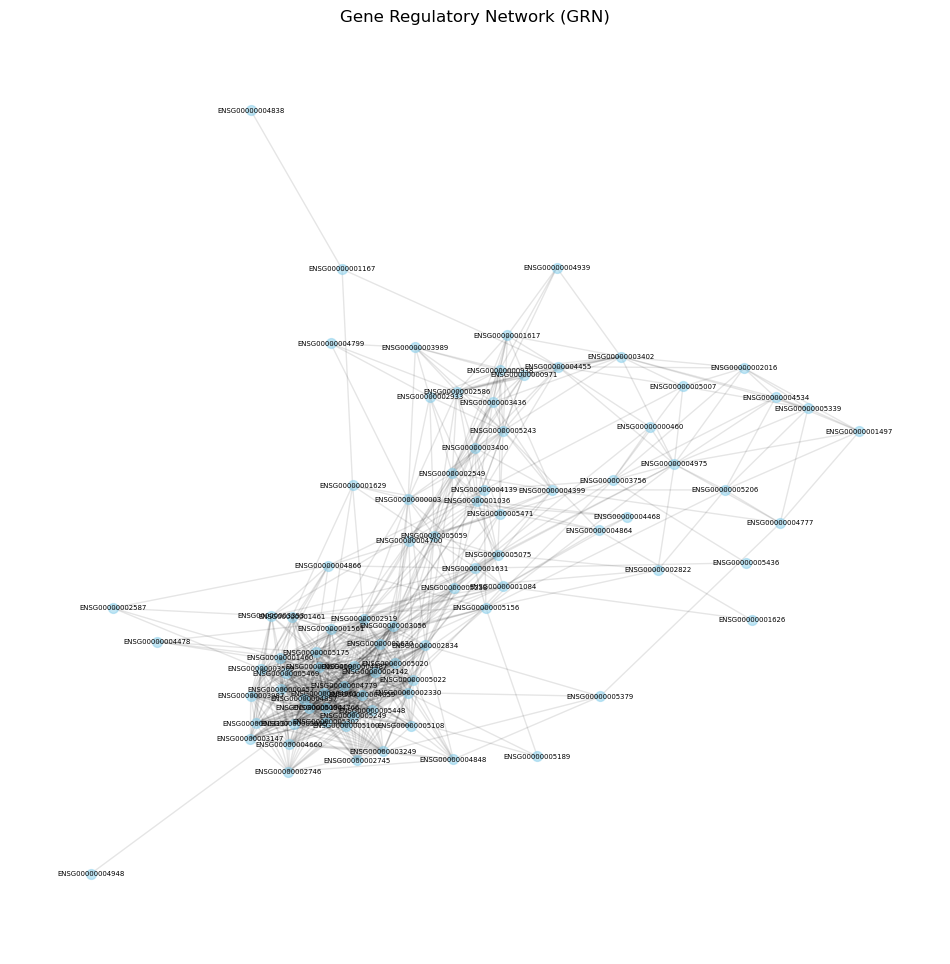

In [50]:
# Assuming 'filtered_correlation_matrix' is your thresholded correlation matrix from previous steps
threshold = 0.5
# Convert the filtered correlation matrix into an adjacency matrix for the graph
# We consider correlations above the threshold as edges in the network

# Create an identity matrix of the same size as the correlation matrix
identity_matrix = np.eye(len(correlation_matrix))

# Create the adjacency matrix by converting the correlation matrix to binary based on the threshold
# and subtracting the identity matrix to remove self-connections
adjacency_matrix = (correlation_matrix > threshold).astype(int) - identity_matrix

# Convert adjacency matrix to an integer type, if necessary
adjacency_matrix = adjacency_matrix.astype(int)

# Ensure no negative values after subtraction (in case of numerical issues)
adjacency_matrix[adjacency_matrix < 0] = 0

# Replace zeros with NaN
adjacency_matrix.replace(0, np.nan, inplace=True)

# Drop all rows and columns that only contain NaN
adjacency_matrix.dropna(axis=0, how='all', inplace=True)  # Drop rows that have all NaN
adjacency_matrix.dropna(axis=1, how='all', inplace=True)  # Drop columns that have all NaN

# Optionally, replace NaNs back with zeros if needed for other processing
adjacency_matrix.fillna(0, inplace=True)

#adjacency_matrix = (correlation_matrix > threshold).astype(int)-np.eye
# print(adjacency_matrix)

# Create a graph from the adjacency matrix
G = nx.from_pandas_adjacency(adjacency_matrix)

# Plot the network
plt.figure(figsize=(12, 12))
# Position nodes using the spring layout algorithm for nice aesthetics
pos = nx.spring_layout(G)
# Draw nodes and edges
nx.draw_networkx_nodes(G, pos, node_color='skyblue', alpha=0.5, node_size=50)
nx.draw_networkx_edges(G, pos, alpha=0.1)
# Draw node labels
nx.draw_networkx_labels(G, pos, font_size=5, font_family='sans-serif')

# Remove the axis
plt.axis('off')
plt.title('Gene Regulatory Network (GRN)')
plt.show()

In [15]:
# G.edges(data=True)

In [51]:
# how many edges and nodes in the graph?
print('The graph has '+str(G.number_of_edges())+' edges and '+str(G.number_of_nodes())+' nodes.')

# divide the number of edges by the number of nodes to get the average degree
print('The average degree of the graph is '+str(G.number_of_edges()/G.number_of_nodes())+'.\n')

The graph has 776 edges and 88 nodes.
The average degree of the graph is 8.818181818181818.



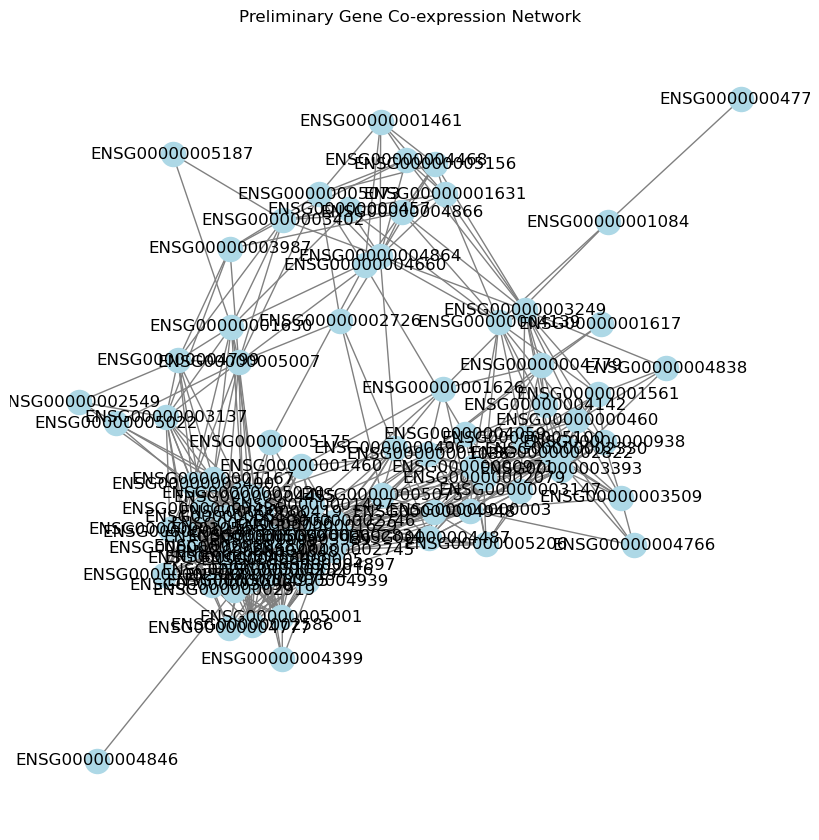

In [49]:
# Selecting a soft-thresholding power, this is usually done through analysis of the scale-free fit index
# For demonstration, we will assume a power of 6
# power = 6
# adjacency_matrix = np.power(correlation_matrix, power)

# Creating a networkx graph from the adjacency matrix

G = nx.from_numpy_array(adjacency_matrix.to_numpy())

# Relabel nodes to correspond to gene names
G = nx.relabel_nodes(G, dict(enumerate(correlation_matrix.columns)))

# Visualizing the network
plt.figure(figsize=(8, 8))
pos = nx.spring_layout(G)
nx.draw(G, pos, with_labels=True, node_color='lightblue', edge_color='gray')
plt.title('Preliminary Gene Co-expression Network')
plt.show()

# Please note: This is a simplistic approach. The WGCNA package in R provides much more
# sophisticated methods for network construction and module detection.


## Sparsification of complex graphs

### Based on simple metrics 

In [52]:
# Define the sparsification functions
def remove_by_closeness(graph, threshold=0.3):
    closeness = nx.closeness_centrality(graph)
    # Create a copy to modify
    modified_graph = graph.copy()
    for gene, centrality in closeness.items():
        if centrality < threshold:
            modified_graph.remove_node(gene)
    return modified_graph

def remove_by_degree(graph, min_degree=3):
    degrees = dict(graph.degree())
    # Create a copy to modify
    modified_graph = graph.copy()
    for gene, degree in degrees.items():
        if degree < min_degree:
            modified_graph.remove_node(gene)
    return modified_graph

# Initialize a dictionary to store graphs
graphs = {}
graphs['original'] = G.copy()  # Store the original graph

# Sparsification by weight threshold
threshold = 0.5
filtered_edges = [(u, v) for u, v, d in G.edges(data=True) if d['weight'] > threshold]
graphs['threshold_0.5'] = nx.Graph()
graphs['threshold_0.5'].add_edges_from(filtered_edges)

# Sparsification by top percentage of weights
top_percentage = 10  # Top 10%
sorted_edges = sorted(G.edges(data=True), key=lambda x: x[2]['weight'], reverse=True)
top_edges_count = int(len(sorted_edges) * (top_percentage / 100))
graphs['top_10_percent'] = nx.Graph()
graphs['top_10_percent'].add_edges_from(sorted_edges[:top_edges_count])

# Apply closeness centrality sparsification
graphs['closeness_below_0.3'] = remove_by_closeness(G, threshold=0.3)

# Apply degree sparsification
graphs['degree_below_3'] = remove_by_degree(G, min_degree=3)

# TODO: density (networkx function) for a series of threshold, plot it and move on based on that
## check networkxs dedensification metohd

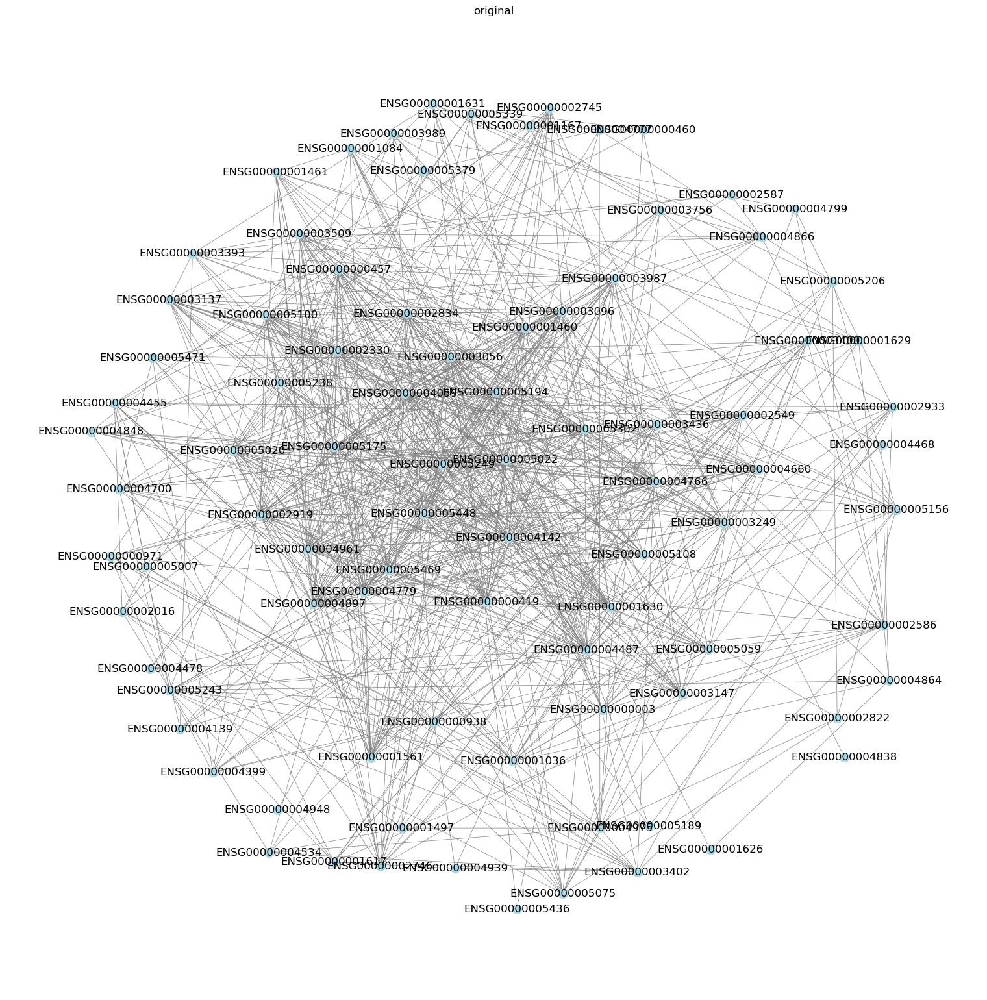

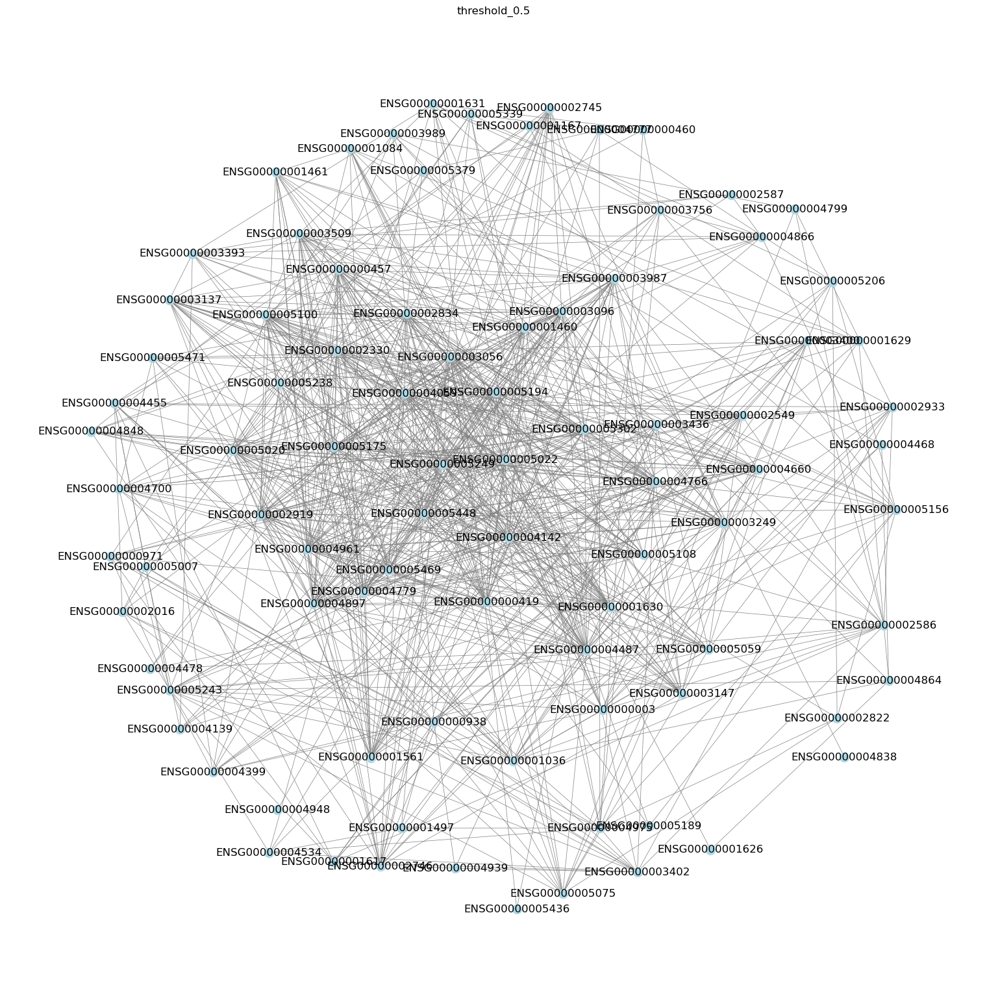

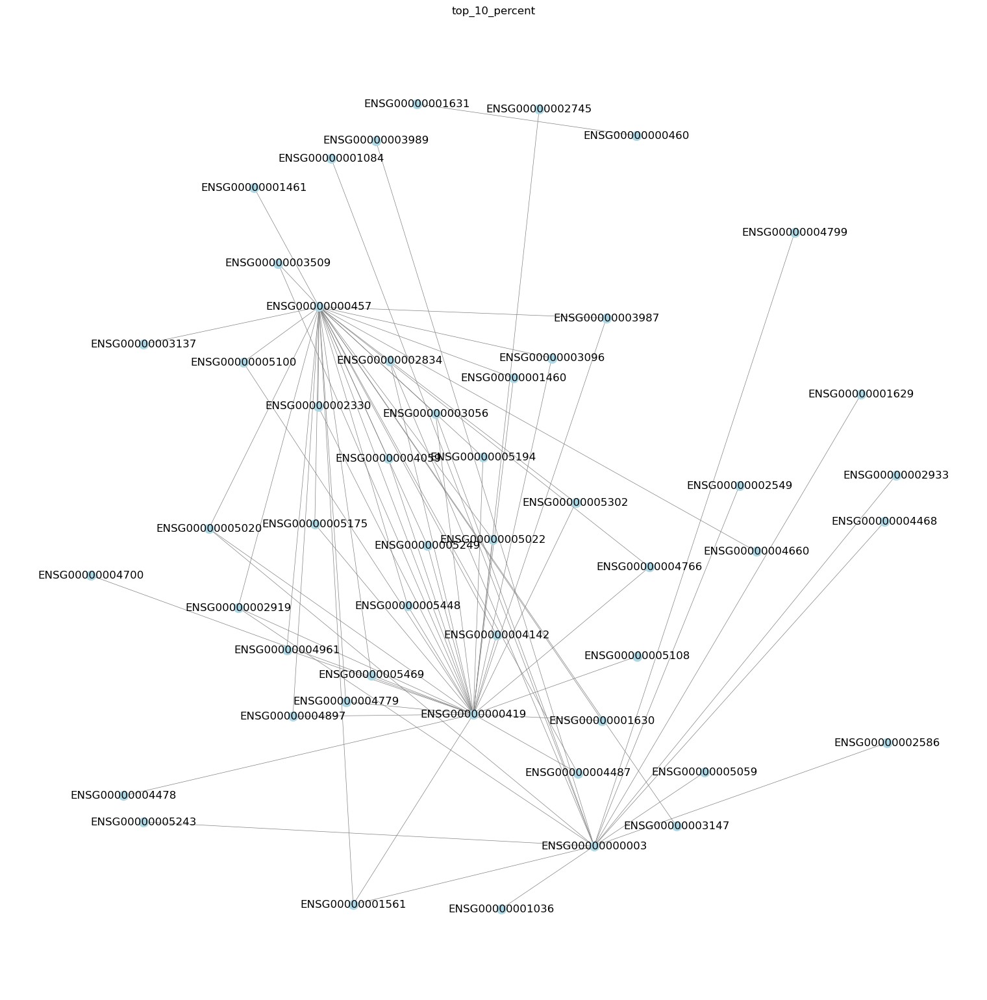

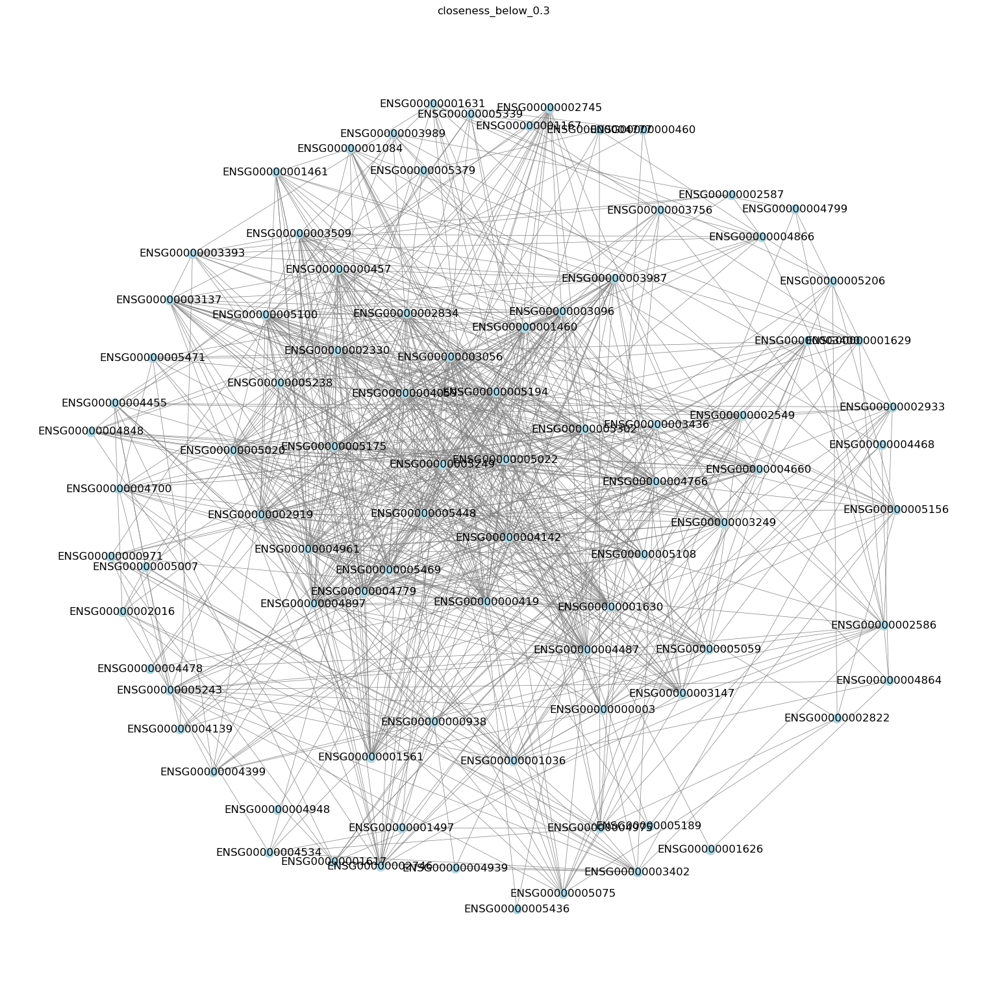

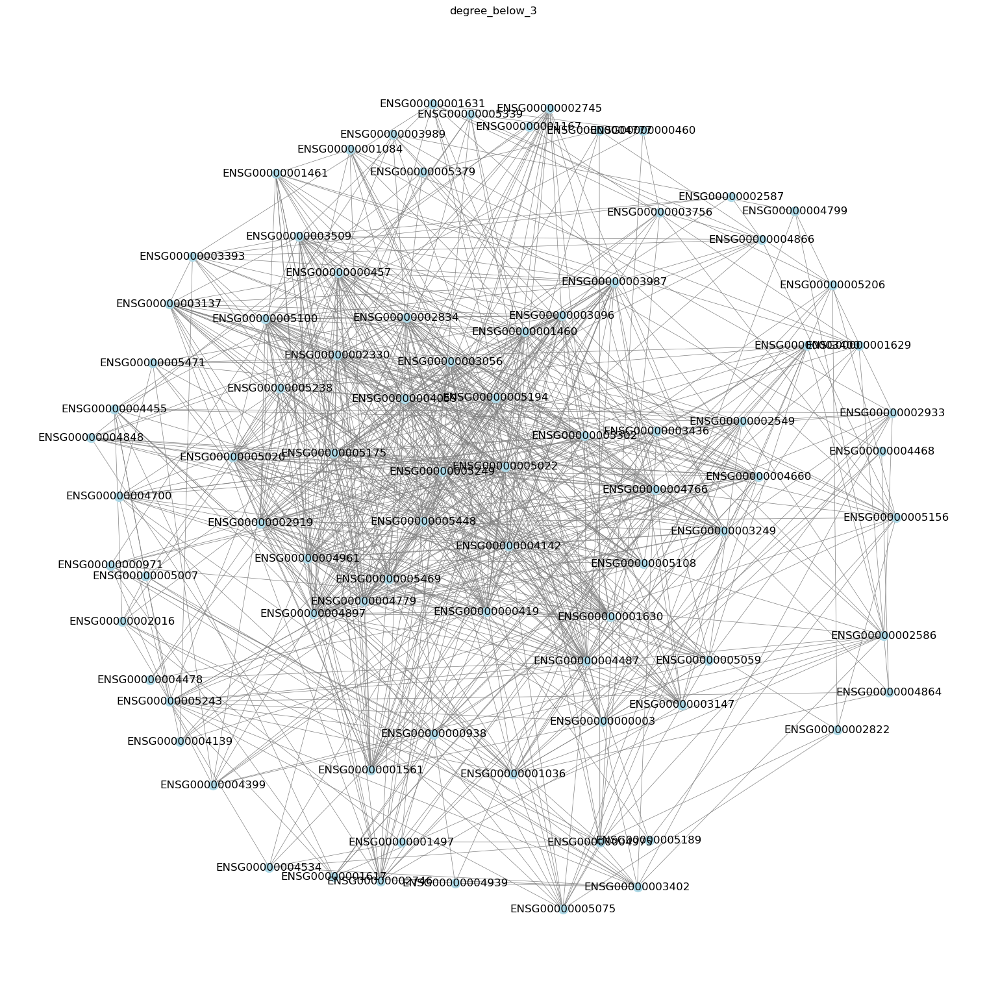

AttributeError: 'dict' object has no attribute 'is_directed'

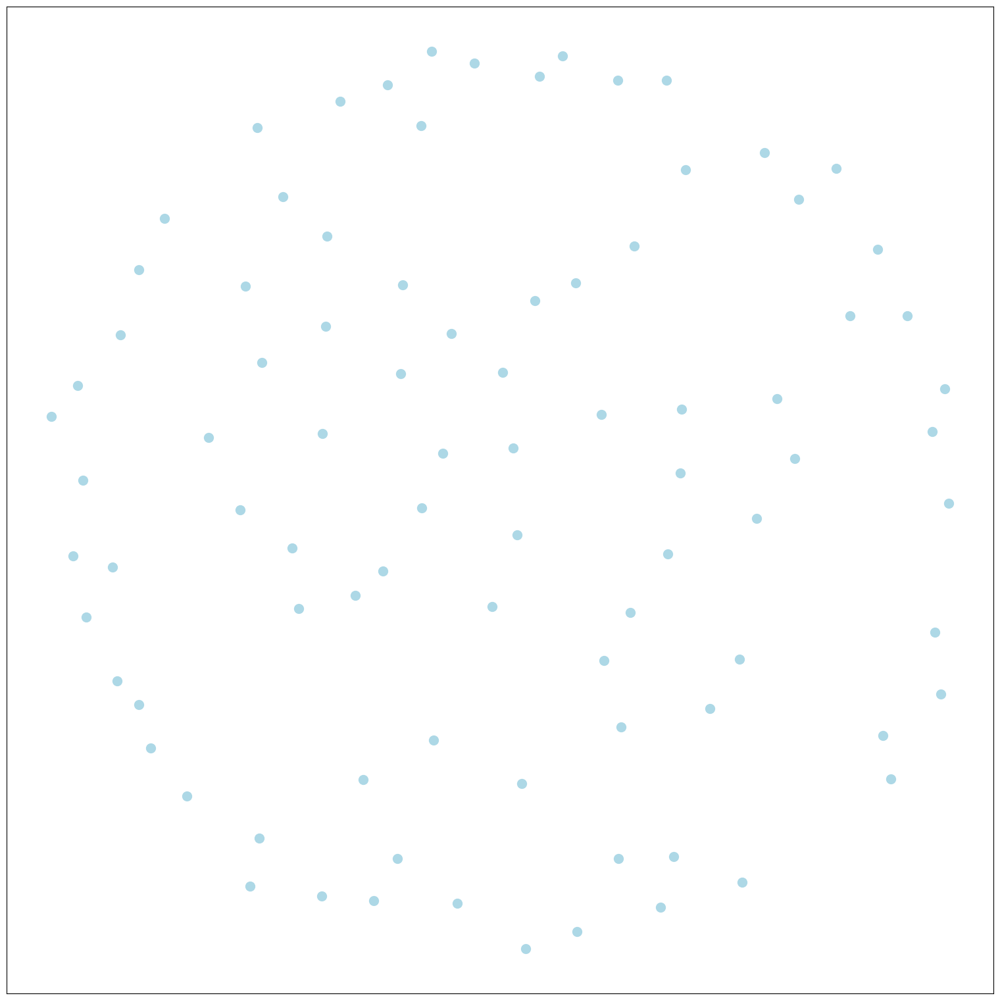

In [54]:
def display_graphs(graph_dict):
    pos = nx.spring_layout(graph_dict['original'], k=2)  # k=2 for more spaced out layout
    
    for name, graph in graph_dict.items():
        plt.figure(figsize=(15, 15))
        # Draw the graph using the specified options
        nx.draw(graph, pos=pos, with_labels=True, node_size=100,
                edge_color='gray', node_color='lightblue', width=0.5)
        plt.title(name)
        plt.show()

display_graphs(graphs)

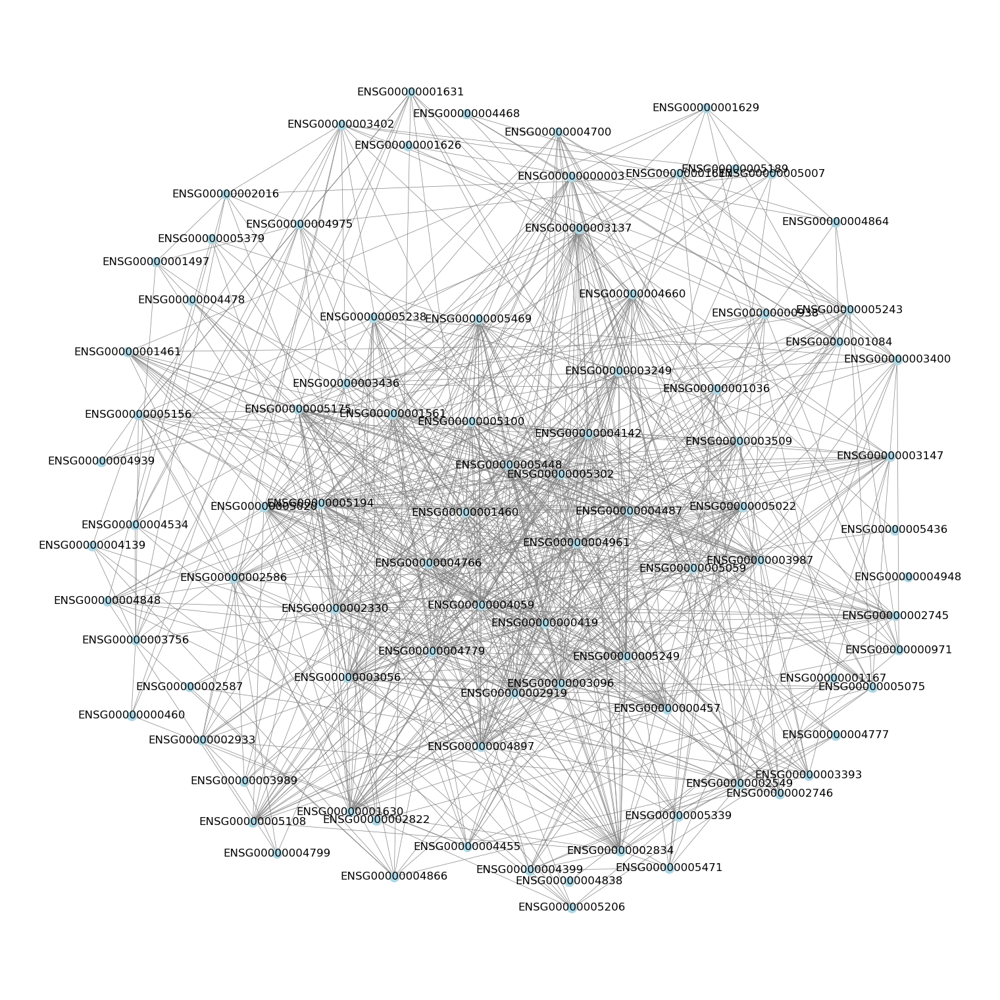

In [45]:
# draw the network with a force directed layout specify plot size and node size and thin light gray edges
plt.figure(figsize=(15,15))

nx.draw(graphs['original'], pos=nx.spring_layout(G,k=2), with_labels=True,node_size=100,edge_color='gray',node_color='lightblue',width=0.5)

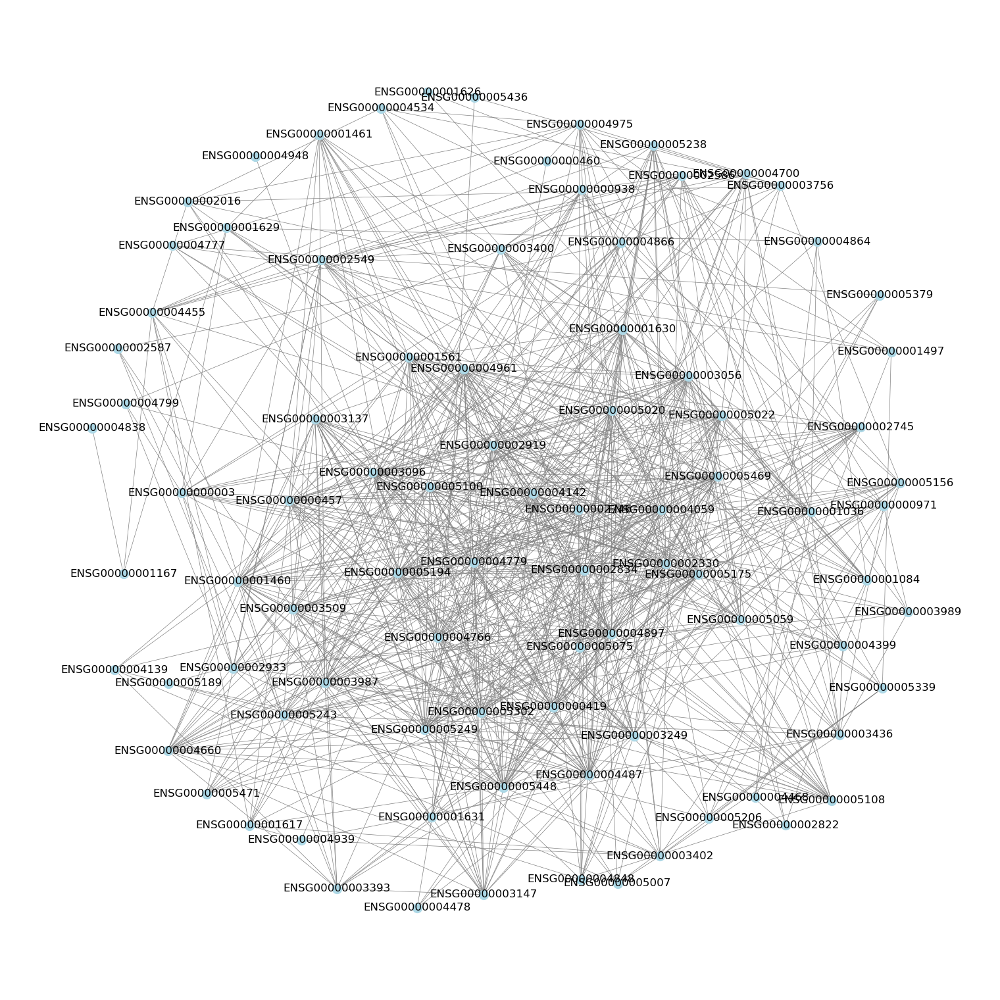

In [42]:
plt.figure(figsize=(15,15))
nx.draw(graphs['threshold_0.5'], pos=nx.spring_layout(G,k=2), with_labels=True,node_size=100,edge_color='gray',node_color='lightblue',width=0.5)


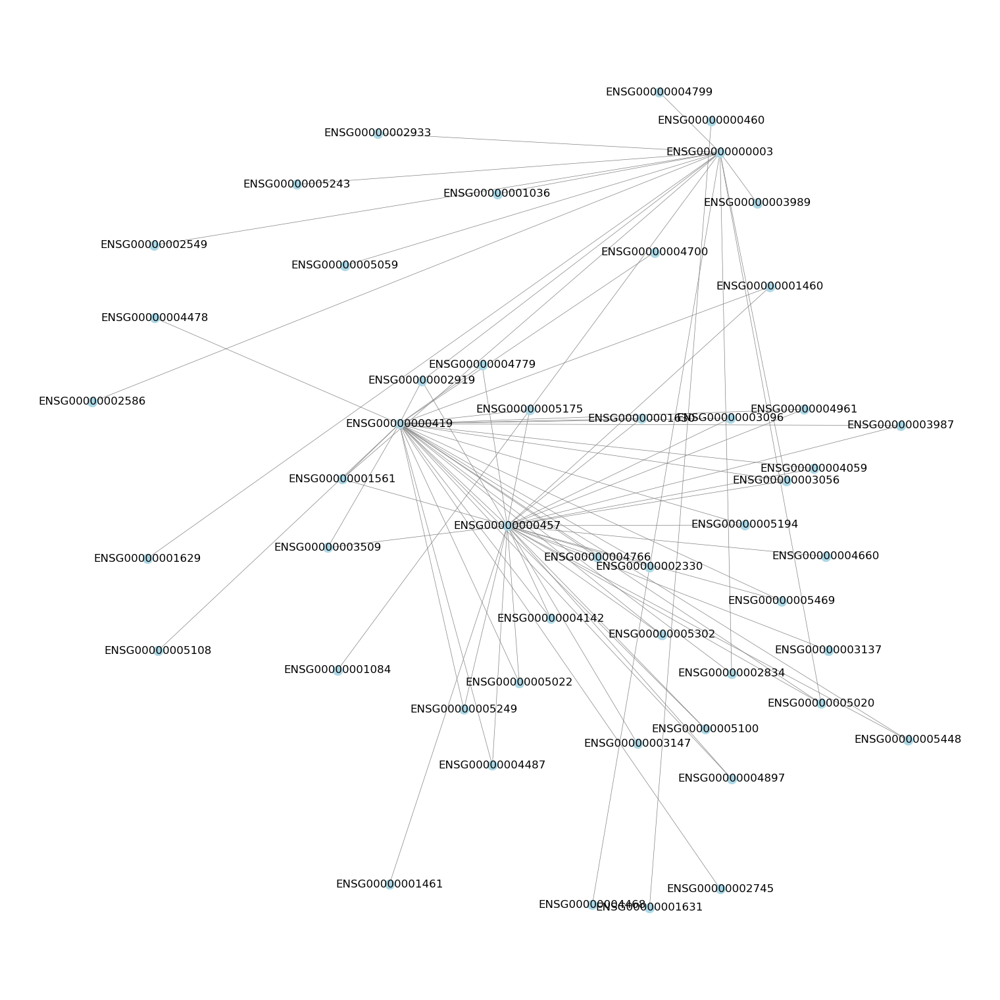

In [43]:
plt.figure(figsize=(15,15))
nx.draw(graphs['top_10_percent'], pos=nx.spring_layout(G,k=2), with_labels=True,node_size=100,edge_color='gray',node_color='lightblue',width=0.5)

In [18]:

# To iterate over all matrices and print them
for name, matrix in correlation_matrices.items():
    print(f"\n{name} Correlation Matrix:")
    print(matrix)


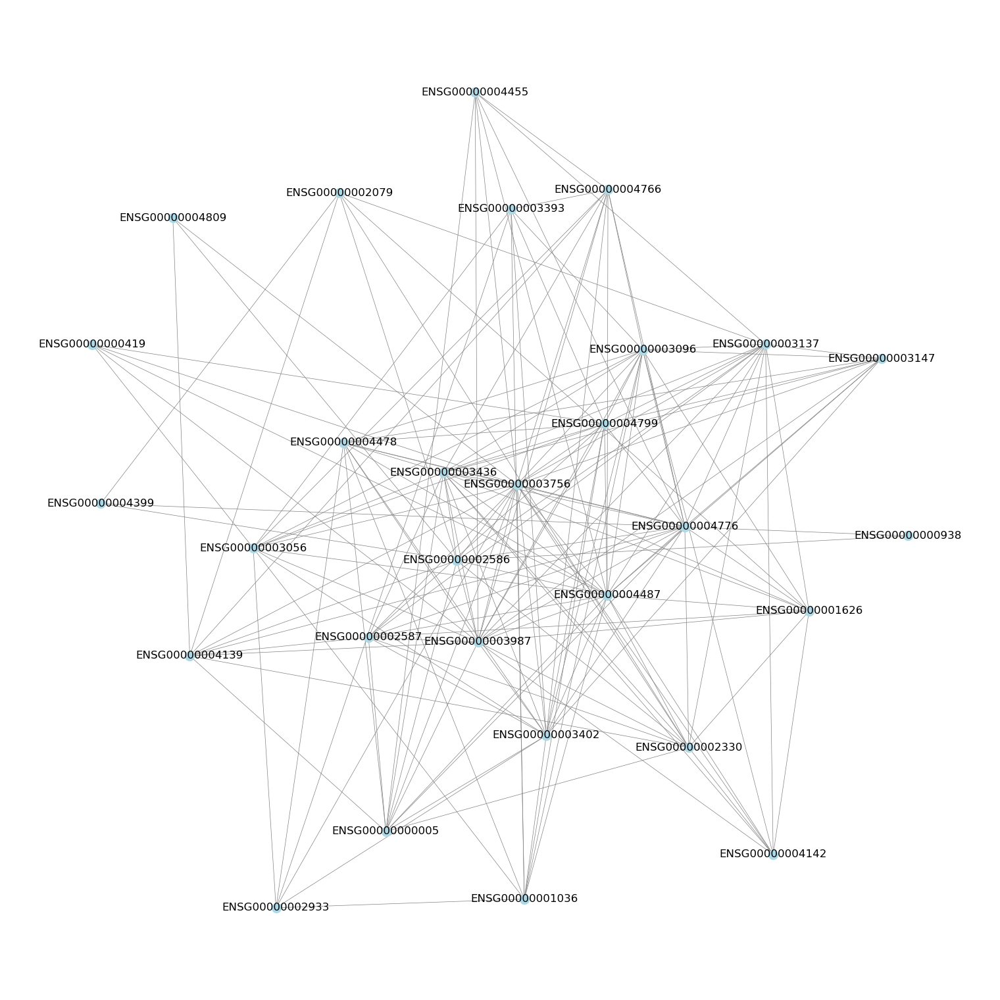

In [19]:
# draw the network with a force directed layout specify plot size and node size and thin light gray edges
plt.figure(figsize=(15,15))
nx.draw(G, pos=nx.spring_layout(G,k=2), with_labels=True,node_size=100,edge_color='gray',node_color='lightblue',width=0.5)

# Bicorr and KNN

In [8]:


def get_k_neighbours(df , k) : 
    k_neighbours = {}
    if abs(w1.max().max()) > 1 : 
        print('Dataframe should be a similarity matrix of max value 1')
    else:
        np.fill_diagonal(df.values , 1)
        for node in df.index : 
            neighbours = df.loc[node].nlargest(k+1).index.to_list()[1:] #Exclude the node itself
            k_neighbours[node] = neighbours
        
    return k_neighbours

def plot_knn_network(df , K , labels , node_colours = ['skyblue'] , node_size = 300) : 
    # Get K-nearest neighbours for each node
    k_neighbours = get_k_neighbours(df , k = K)
    
    # Create a NetworkX graph
    G = nx.Graph()
    
        # Add nodes to the graph
    G.add_nodes_from(df.index)

    # Add edges based on the k-nearest neighbours
    for node, neighbours in k_neighbours.items():
        for neighbor in neighbours:
            G.add_edge(node, neighbor)

    plt.figure(figsize=(10, 8))
    nx.draw(G, with_labels=False, font_weight='bold', node_size=node_size, node_color=node_colours, font_size=8)
    
    return G

In [55]:
def apply_knn_sparsification(G, k=5, mode='distance'):
    """
    Apply kNN sparsification to the graph G.
    :param G: A NetworkX graph where edges have a 'weight' attribute.
    :param k: The number of nearest neighbors to retain for each node.
    :param mode: 'distance' (smaller is closer) or 'similarity' (larger is closer).
    """
    # Create a new graph to store the sparsified version
    sparsified_graph = nx.Graph()
    
    # Iterate over all nodes and apply kNN selection
    for node in G.nodes():
        neighbors = list(G[node].items())  # Get all neighbors and their edge data
        # Sort neighbors according to weight, which could represent distance or similarity
        if mode == 'distance':
            # For distance, closer neighbors have smaller weights; keep the smallest
            neighbors.sort(key=lambda x: x[1]['weight'])
            chosen_neighbors = neighbors[:k]  # Pick k smallest
        elif mode == 'similarity':
            # For similarity, closer neighbors have larger weights; keep the largest
            neighbors.sort(key=lambda x: x[1]['weight'], reverse=True)
            chosen_neighbors = neighbors[:k]  # Pick k largest

        # Add edges from the node to its k-nearest neighbors
        for neighbor, edge_data in chosen_neighbors:
            sparsified_graph.add_edge(node, neighbor, weight=edge_data['weight'])

    return sparsified_graph

# Example usage:
# Assuming 'G' is your original graph and each edge has a 'weight' attribute
k = 3  # Number of neighbors
sparsified_G = apply_knn_sparsification(G, k, mode='distance')  # Adjust mode based on your data


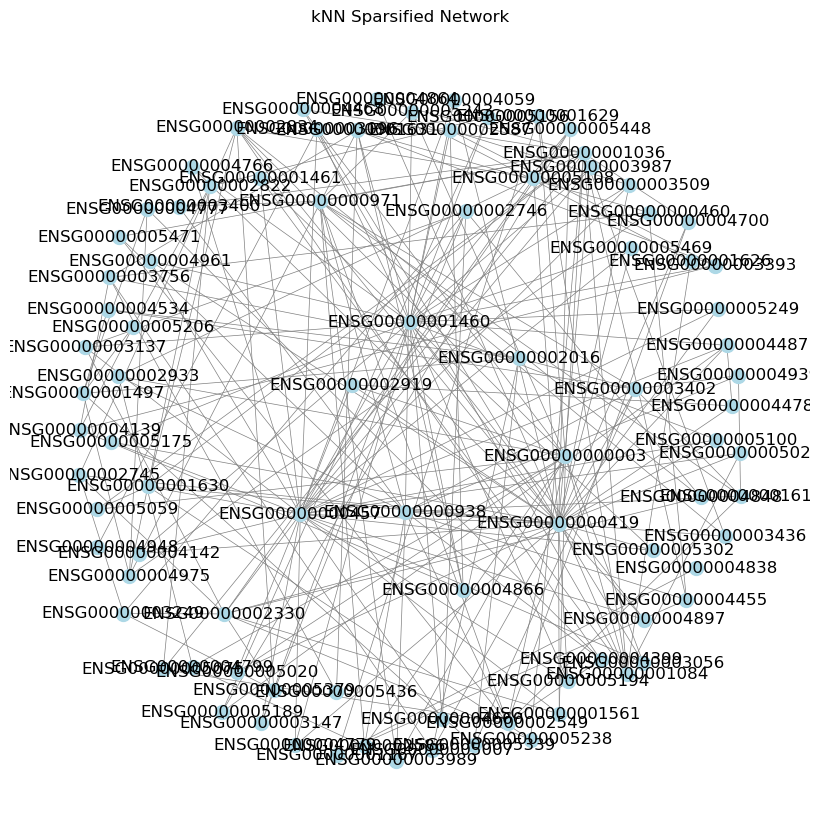

In [57]:
pos = nx.spring_layout(sparsified_G, k=2)  # k=2 increases the space between nodes

# Now, draw the graph with the specified node and edge aesthetics
plt.figure(figsize=(8, 8))
nx.draw(sparsified_G, pos, with_labels=True, node_size=100,
        edge_color='gray', node_color='lightblue', width=0.5)
plt.title("kNN Sparsified Network")
plt.show()

## Storing generated networks

In [ ]:
# Simple way to store them is in a pickle file

# Serialize and store the graph
with open('my_network_graph.pkl', 'wb') as f:
    pickle.dump(G, f)

In [ ]:
# and then loading it back to a NetworkX Graph object from the pickle file

# Load the graph
with open('my_network_graph.pkl', 'rb') as f:
    G_loaded = pickle.load(f)

# Inspect the loaded graph
print("Nodes:", G_loaded.nodes())
print("Edges:", G_loaded.edges(data=True))

## Generation Scotland

In [ ]:
with open('../ISMB_GS_Data.pkl' , 'rb') as file : 
    loaded_data = pd.read_pickle(file)

In [ ]:
w1 = loaded_data['DNAm_w1'].dropna()
w3 = loaded_data['DNAm_w3'].dropna()
phenotypes = loaded_data['Phenotypes']

In [ ]:
# Setting Up the Programming Environment
# %pip install networkx

# import modules for use in the notebook

# handling www based requests (like APIs)
import urllib as ul

# standard Python data handling modules
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import json

# working with networks
import networkx as nx

# Setting up PIP network using String

In [ ]:
# create a concatenated list of gene names as strings
# note we are taking gene names from the 'gene' column of the dataframe we obtained from the EWAS catalog and filtered
# to common CpG and Gene sites above. The join function then concatenates them using the '%0D' string
# to stitch them all together. This string will be used to help us build the API query URL.
external_gene_names = '%0D'.join(map(str,df_filt['gene'].iloc[:300].drop_duplicates()))

# pass the list of Gene Names to the String-DB API return the String-IDs
# we first form the query url using the 'get_string_ids' API function which takes a list of identifiers and
# converts them into the internal String-DB accession IDs. This massively speeds up the search and allows us to
# search for more than 10 at once which is an API restriction for other API functions if String-DB internal accessions 
# aren't used.
query_url = 'https://string-db.org/api/tsv-no-header/get_string_ids?identifiers='+external_gene_names+'&species=9606&format=only-ids'

# use the urllib library to retrieve the String-DB internal IDs
result = ul.request.urlopen(query_url).read().decode('utf-8')

# now we want to query String-DB to retrieve interactions from this list of String-DB IDs
# we create a concatenated list of stringdbIDs in much the same way as above for the Entrez Gene IDs
stringdbIDs = '%0D'.join(result.splitlines())

# again we build the query for interactions using the String-DB IDs
query_url = 'https://string-db.org/api/tsv/network?identifiers='+stringdbIDs+'&species=9606'

# again using urllib to retrieve the interactions these are returned in a standard tab delimied text format
interactions = ul.request.urlopen(query_url).read().decode('utf-8').splitlines()

# we need to split the result by these 'tabs' (\t - is used to identfy them)
int_test = [interaction.split('\t') for interaction in interactions]

# we extract the field names from the first row
column_names = int_test[:1][0]

# create a Pandas dataframe of the interaction data we have just retrieved from String-DB
interactions_df = pd.DataFrame(int_test,columns=column_names)

# delete the first row that held the fieldnames but we no longer need
interactions_df = interactions_df.drop(labels=0,axis=0)

# remove any duplicate rows
final_interactions = interactions_df.drop_duplicates()

# show the top of the protein-protein interaction table
final_interactions.head()